In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
import pandas as pd

data = pd.read_csv(r"/content/drive/My Drive/IDC410/Data.csv")
print(data.columns)
data.head()

Index(['Unnamed: 0', 'sentence', 'label'], dtype='object')


,Unnamed: 0,sentence,label
0,0,Beyoncé Giselle Knowles-Carter (/biːˈjɒnseɪ/ b...,sentence
1,1,"Born and raised in Houston, Texas, she perform...",sentence
2,2,"Managed by her father, Mathew Knowles, the gro...",sentence
3,3,Their hiatus saw the release of Beyoncé's debu...,sentence
4,4,Following the disbandment of Destiny's Child i...,sentence


**Using TF-IDF Vectorization :**
---
---

In [ ]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer

X = data['sentence']

vectorizer = TfidfVectorizer(stop_words='english')
X_tfidf = vectorizer.fit_transform(X)

print("TF-IDF matrix shape:", X_tfidf.shape)
print("TF-IDF matrix :")
print(X_tfidf[:])

bag_of_words = vectorizer.fit_transform(X)
print("Sparsity of bag_of_words : ", len(bag_of_words.data)/(bag_of_words.shape[0]*bag_of_words.shape[1])*100)
print("The number of bag of words in data : ",len(bag_of_words.data))
print(list(vectorizer.vocabulary_.keys()))

TF-IDF matrix shape: (235110, 80140)
TF-IDF matrix :
  (0, 704)	0.24279089988148814
  (0, 56627)	0.2110594440724014
  (0, 59162)	0.1731866809396144
  (0, 66815)	0.26220420965233104
  (0, 65744)	0.2157413048745039
  (0, 2587)	0.1429798869235725
  (0, 64342)	0.17361866942180795
  (0, 8822)	0.17988277464676877
  (0, 63170)	0.1770924836552315
  (0, 79488)	0.3274580061939067
  (0, 6940)	0.26435842624138517
  (0, 49689)	0.3274580061939067
  (0, 7600)	0.25071547028561053
  (0, 11216)	0.2611909177287956
  (0, 38909)	0.2916422148217396
  (0, 28993)	0.3169825587507217
  (0, 7505)	0.18962151463493046
  (1, 18996)	0.2568166209232313
  (1, 30115)	0.15718589540450204
  (1, 28983)	0.2459986204277984
  (1, 40286)	0.19703234716709683
  (1, 40029)	0.17591681027797917
  (1, 25198)	0.24680318691184847
  (1, 61678)	0.22901858148060528
  (1, 12615)	0.39864850759532167
  :	:
  (235098, 8307)	0.408248290463863
  (235099, 73503)	0.6717980176415868
  (235099, 12313)	0.5313122516112783
  (235099, 54978)	0.516134

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


AUC for Logistic Regression: 0.8878
AUC for Decision Tree: 0.7197
AUC for Random Forest: 0.8266
AUC for Naive Bayes: 0.8277


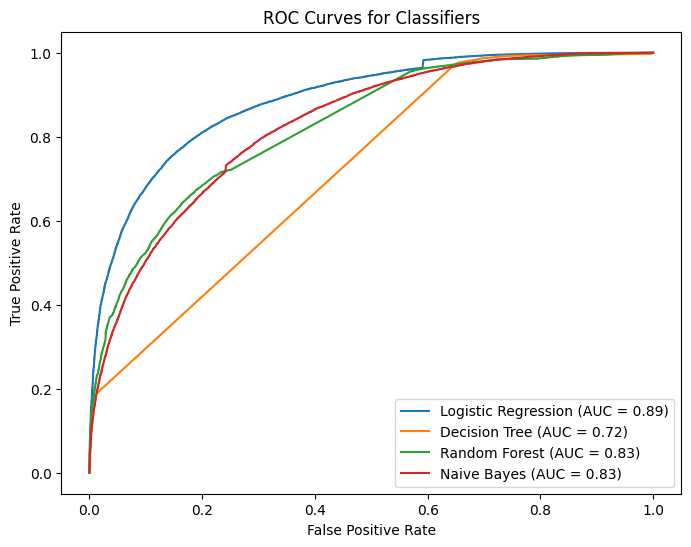

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import roc_auc_score, RocCurveDisplay
import matplotlib.pyplot as plt

X = data['sentence']
y = data['label']

vectorizer = TfidfVectorizer(stop_words='english')
X_tfidf = vectorizer.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_tfidf, y, test_size=0.20, random_state=42)

logistic_regression = LogisticRegression()
decision_tree = DecisionTreeClassifier(max_depth=25)
random_forest = RandomForestClassifier(max_depth=15, n_estimators=40)
naive_bayes = MultinomialNB()

logistic_regression.fit(X_train, y_train)
decision_tree.fit(X_train, y_train)
random_forest.fit(X_train, y_train)
naive_bayes.fit(X_train, y_train)

classifiers = {
    "Logistic Regression": logistic_regression,
    "Decision Tree": decision_tree,
    "Random Forest": random_forest,
    "Naive Bayes": naive_bayes
}

plt.figure(figsize=(8, 6))
for name, clf in classifiers.items():
    RocCurveDisplay.from_estimator(clf, X_test, y_test, ax=plt.gca(), name=name)
    auc_score = roc_auc_score(y_test, clf.predict_proba(X_test)[:, 1])
    print(f"AUC for {name}: {auc_score:.4f}")

plt.title("ROC Curves for Classifiers")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.show()

**Using LSA (Latent Semantic Analysis) :**
---
---

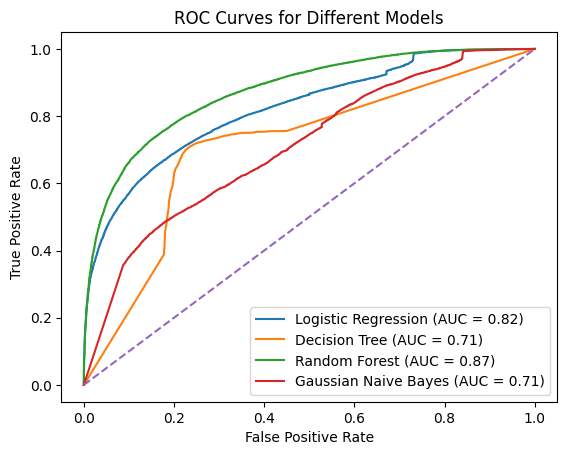

In [ ]:
import pandas as pd
import numpy as np
import re

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

data = data[['sentence', 'label']].copy()
data.dropna(inplace=True)


def preprocess_text(sen):
    sentence = re.sub('[^a-zA-Z]', ' ', sen)
    sentence = re.sub(r"\s+[a-zA-Z]\s+", ' ', sentence)
    sentence = re.sub(r'\s+', ' ', sentence)
    return sentence


X = data['sentence'].apply(preprocess_text)
y = data['label']


count_vectorizer = CountVectorizer(stop_words='english')
X_counts = count_vectorizer.fit_transform(X)


svd = TruncatedSVD(n_components=100, random_state=42)
X_lsa = svd.fit_transform(X_counts)


X_train, X_test, y_train, y_test = train_test_split(X_lsa, y, test_size=0.20, random_state=42)


lr = LogisticRegression()
dt = DecisionTreeClassifier(max_depth=25)
rf = RandomForestClassifier(max_depth=15, n_estimators=40)
nb = GaussianNB()


lr.fit(X_train, y_train)
dt.fit(X_train, y_train)
rf.fit(X_train, y_train)


X_train_dense = X_train.todense() if hasattr(X_train, 'todense') else X_train
X_test_dense = X_test.todense() if hasattr(X_test, 'todense') else X_test


nb.fit(X_train_dense, y_train)


plt.figure()

# Logistic Regression
fpr_lr, tpr_lr, _ = roc_curve(y_test, lr.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_lr = auc(fpr_lr, tpr_lr)
plt.plot(fpr_lr, tpr_lr, label=f'Logistic Regression (AUC = {auc_lr:.2f})')

# Decision Tree
fpr_dt, tpr_dt, _ = roc_curve(y_test, dt.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_dt = auc(fpr_dt, tpr_dt)
plt.plot(fpr_dt, tpr_dt, label=f'Decision Tree (AUC = {auc_dt:.2f})')

# Random Forest
fpr_rf, tpr_rf, _ = roc_curve(y_test, rf.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_rf = auc(fpr_rf, tpr_rf)
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.2f})')

# Gaussian Naive Bayes
fpr_nb, tpr_nb, _ = roc_curve(y_test, nb.predict_proba(X_test_dense)[:, 1], pos_label='sentence')
auc_nb = auc(fpr_nb, tpr_nb)
plt.plot(fpr_nb, tpr_nb, label=f'Gaussian Naive Bayes (AUC = {auc_nb:.2f})')


plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Different Models')
plt.legend()
plt.show()

In [ ]:
# Important LSA quantities

from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(analyzer='word',
                             min_df=10,
                             stop_words='english',
                             lowercase=True,
                             token_pattern='[a-zA-Z0-9]{3,}')
data_vectorized = vectorizer.fit_transform(data['sentence'])


# Explained variance ratio for each component
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD(n_components=100, random_state=42)
X_lsa = svd.fit_transform(X_counts)
explained_variance_ratio = svd.explained_variance_ratio_
print("Explained Variance Ratio:")
print(explained_variance_ratio)
print("\nTotal Explained Variance: {:.2f}%".format(np.sum(explained_variance_ratio) * 100))

# Singular values
singular_values = svd.singular_values_
print("\nSingular Values:")
print(singular_values)

# Terms from CountVectorizer
terms = count_vectorizer.get_feature_names_out()


svd2 = TruncatedSVD(n_components=2)
lsa2 = svd2.fit_transform(data_vectorized.T)

# Computing U, Sigma_matrix, and VT matrices
U = lsa2 / svd2.singular_values_
Sigma_matrix = np.diag(svd2.singular_values_)
VT = svd2.components_

print("\nMatrix U:")
print(U)
print("\nSigma Matrix:")
print(Sigma_matrix)
print("\nMatrix VT:")
print(VT)


# Top terms in each component/topic
print("\nTop terms in each component/topic:")
n_top_terms = 20

for i, comp in enumerate(svd.components_):
    print(f"\nTopic {i + 1}:")
    top_indices = np.argsort(comp)[::-1][:n_top_terms]
    top_terms = [terms[idx] for idx in top_indices]
    print(", ".join(top_terms))


print("\nReduced matrices (LSA):")
print(X_lsa)

Explained Variance Ratio:
[0.01042078 0.00443001 0.00446213 0.00361503 0.00359194 0.00351397
 0.00341883 0.00322781 0.00289534 0.00271496 0.00251121 0.00242003
 0.00236841 0.00208681 0.00206476 0.00196775 0.00189674 0.00180941
 0.0018029  0.0017678  0.00172261 0.001687   0.0016416  0.00163518
 0.00161632 0.00155861 0.00153953 0.00151559 0.0014763  0.00145178
 0.00141987 0.0013878  0.00139542 0.00137794 0.00137276 0.00136239
 0.00133034 0.00129747 0.0012879  0.00127125 0.0012607  0.00126157
 0.00125145 0.00123439 0.00121646 0.00119483 0.00118168 0.00116506
 0.00116116 0.00115472 0.00114993 0.00112898 0.00111653 0.00111422
 0.00109703 0.00109603 0.0010882  0.00107914 0.00107531 0.00107029
 0.00106562 0.00106317 0.00104838 0.00104222 0.00103412 0.00103183
 0.00101707 0.0010114  0.00100618 0.00100198 0.00098542 0.00097943
 0.00097199 0.0009693  0.00096395 0.00095446 0.0009505  0.00094406
 0.000939   0.00093217 0.00092368 0.00091851 0.00091233 0.00090606
 0.00090496 0.00089791 0.00089413 0.

**Using LDA (Linear Discriminant Analysis) :**
---
---

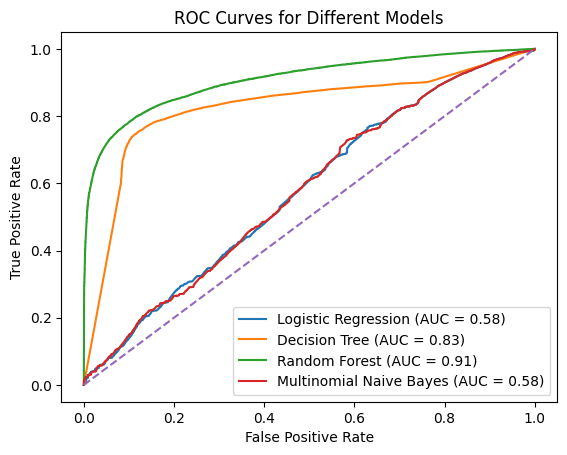

In [ ]:
import pandas as pd
import numpy as np
import re

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt


data = data[['sentence', 'label']].copy()
data.dropna(inplace=True)

def preprocess_text(sen):
    sentence = re.sub('[^a-zA-Z]', ' ', sen)
    sentence = re.sub(r"\s+[a-zA-Z]\s+", ' ', sentence)
    sentence = re.sub(r'\s+', ' ', sentence)
    return sentence

X = data['sentence'].apply(preprocess_text)
y = data['label']

count_vectorizer = CountVectorizer(stop_words='english')
X_counts = count_vectorizer.fit_transform(X)

lda = LatentDirichletAllocation(n_components=10, random_state=42)
X_lda = lda.fit_transform(X_counts)

X_train, X_test, y_train, y_test = train_test_split(X_lda, y, test_size=0.20, random_state=42)

lr = LogisticRegression()
dt = DecisionTreeClassifier(max_depth=25)
rf = RandomForestClassifier(max_depth=15, n_estimators=40)
nb = MultinomialNB()

lr.fit(X_train, y_train)
dt.fit(X_train, y_train)
rf.fit(X_train, y_train)
nb.fit(X_train, y_train)

plt.figure()

# Logistic Regression
fpr_lr, tpr_lr, _ = roc_curve(y_test, lr.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_lr = auc(fpr_lr, tpr_lr)
plt.plot(fpr_lr, tpr_lr, label=f'Logistic Regression (AUC = {auc_lr:.2f})')

# Decision Tree
fpr_dt, tpr_dt, _ = roc_curve(y_test, dt.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_dt = auc(fpr_dt, tpr_dt)
plt.plot(fpr_dt, tpr_dt, label=f'Decision Tree (AUC = {auc_dt:.2f})')

# Random Forest
fpr_rf, tpr_rf, _ = roc_curve(y_test, rf.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_rf = auc(fpr_rf, tpr_rf)
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.2f})')

# Multinomial Naive Bayes
fpr_nb, tpr_nb, _ = roc_curve(y_test, nb.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_nb = auc(fpr_nb, tpr_nb)
plt.plot(fpr_nb, tpr_nb, label=f'Multinomial Naive Bayes (AUC = {auc_nb:.2f})')

plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Different Models')
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import numpy as np

def color_green(val):
    """Style function to color values green if greater than 0.1."""
    if isinstance(val, str):
        return 'color: black'

    color = 'green' if val > 0.1 else 'black'
    return f'color: {color}'

def make_bold(val):
    """Style function to bold values if greater than 0.1."""
    if isinstance(val, str):
        return 'font-weight: normal'

    weight = 700 if val > 0.1 else 400
    return f'font-weight: {weight}'

# Creating Document-Topic Matrix
def create_document_topic_matrix(lda_model, data_vectorized):
    lda_output = lda_model.transform(data_vectorized)

    topicnames = [f"Topic{i}" for i in range(lda_model.n_components)]
    docnames = [f"Doc{i}" for i in range(data_vectorized.shape[0])]

    df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)

    df_document_topic['Dominant Topic'] = df_document_topic.idxmax(axis=1)

    styled_document_topic = df_document_topic.head(15).style.applymap(color_green).applymap(make_bold)

    return styled_document_topic

# Creating Topic-Keyword DataFrame
def create_topic_keyword_dataframe(lda_model):
    topic_keywords = lda_model.components_


    df_topic_keywords = pd.DataFrame(topic_keywords, columns=[f'Word {i}' for i in range(topic_keywords.shape[1])])


    df_topic_keywords.index = [f'Topic {i}' for i in range(topic_keywords.shape[0])]


    styled_topic_keywords = df_topic_keywords.style.applymap(color_green).applymap(make_bold)

    return styled_topic_keywords


document_topic_matrix = create_document_topic_matrix(lda, X_counts)
topic_keyword_dataframe = create_topic_keyword_dataframe(lda)

print("Styled Document-Topic Matrix:")
display(document_topic_matrix)

print("\nStyled Topic-Keyword DataFrame:")
display(topic_keyword_dataframe)

Styled Document-Topic Matrix:


,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,Topic7,Topic8,Topic9,Dominant Topic
Doc0,0.010000,0.010000,0.010000,0.120000,0.010000,0.370000,0.010000,0.350000,0.010000,0.130000,Topic5
Doc1,0.010000,0.010000,0.200000,0.010000,0.380000,0.010000,0.010000,0.380000,0.010000,0.010000,Topic4
Doc2,0.010000,0.010000,0.010000,0.010000,0.010000,0.180000,0.010000,0.430000,0.330000,0.010000,Topic7
Doc3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.190000,0.770000,0.000000,Topic8
Doc4,0.010000,0.010000,0.080000,0.070000,0.010000,0.010000,0.010000,0.080000,0.730000,0.010000,Topic8
Doc5,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.940000,0.010000,Topic8
Doc6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.550000,0.430000,0.000000,Topic7
Doc7,0.010000,0.010000,0.010000,0.010000,0.010000,0.130000,0.190000,0.630000,0.010000,0.010000,Topic7
Doc8,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.010000,0.940000,0.010000,Topic8
Doc9,0.010000,0.010000,0.010000,0.250000,0.010000,0.010000,0.010000,0.700000,0.010000,0.010000,Topic7



Styled Topic-Keyword DataFrame:


**Using One Word Embedding :**
---
---

[=========-----------------------------------------] 18.3% 23.5/128.1MB downloaded

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[==========================================--------] 84.4% 108.0/128.1MB downloaded

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[==================================================] 100.0% 128.1/128.1MB downloaded


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


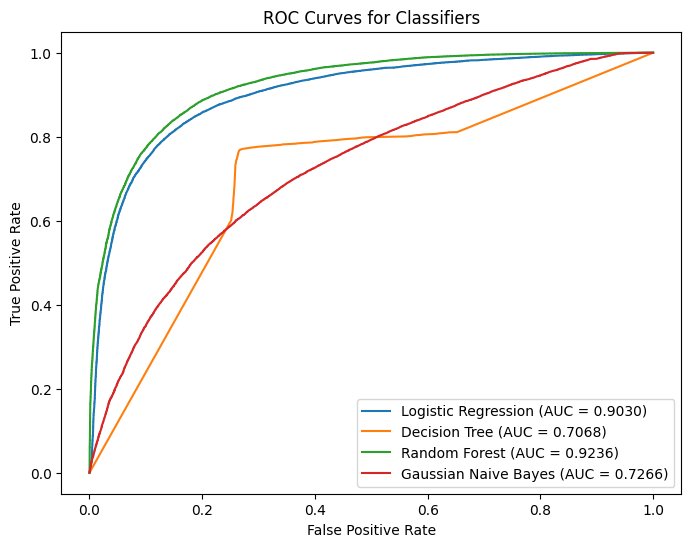

In [ ]:
import pandas as pd
import numpy as np
import re

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
import gensim.downloader as api


data = data[['sentence', 'label']].copy()
data.dropna(inplace=True)

def preprocess_text(sen):
    sentence = re.sub('[^a-zA-Z]', ' ', sen)
    sentence = re.sub(r"\s+[a-zA-Z]\s+", ' ', sentence)
    sentence = re.sub(r'\s+', ' ', sentence)
    return sentence

X = data['sentence'].apply(preprocess_text)
y = data['label']


word_embeddings = api.load("glove-wiki-gigaword-100")


def sentence_to_vector(sentence):
    words = sentence.split()
    vectors = [word_embeddings[word] for word in words if word in word_embeddings]
    if vectors:
        return np.mean(vectors, axis=0)
    else:
        return np.zeros((100,))

X_vectors = np.array([sentence_to_vector(sentence) for sentence in X])


X_train, X_test, y_train, y_test = train_test_split(X_vectors, y, test_size=0.20, random_state=42)


logistic_regression = LogisticRegression()
decision_tree = DecisionTreeClassifier(max_depth=25)
random_forest = RandomForestClassifier(max_depth=15, n_estimators=40)
gaussian_nb = GaussianNB()


logistic_regression.fit(X_train, y_train)
decision_tree.fit(X_train, y_train)
random_forest.fit(X_train, y_train)
gaussian_nb.fit(X_train, y_train)


classifiers = {
    "Logistic Regression": logistic_regression,
    "Decision Tree": decision_tree,
    "Random Forest": random_forest,
    "Gaussian Naive Bayes": gaussian_nb
}


plt.figure(figsize=(8, 6))
for name, clf in classifiers.items():
    if hasattr(clf, 'predict_proba'):
        y_probs = clf.predict_proba(X_test)[:, 1]
    else:
        y_probs = clf.predict(X_test)

    fpr, tpr, _ = roc_curve(y_test, y_probs)
    auc_score = auc(fpr, tpr)

    plt.plot(fpr, tpr, label=f'{name} (AUC = {auc_score:.4f})')


plt.title("ROC Curves for Classifiers")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.show()

**Using One Sentence Embedding :**
---
---

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


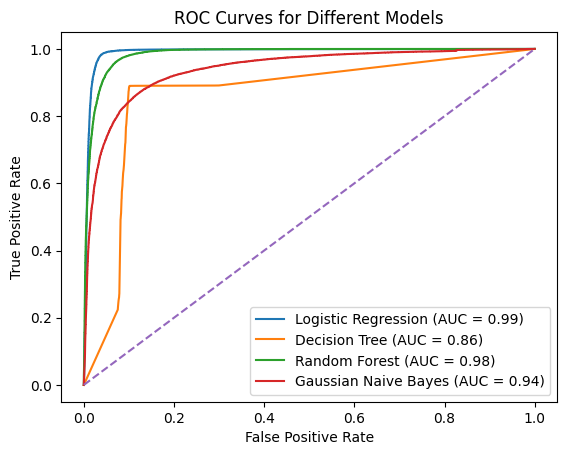

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from gensim.models import Word2Vec


data = data[['sentence', 'label']].copy()
data.dropna(inplace=True)

def preprocess_text(sen):
    return sen if isinstance(sen, str) else str(sen)

X = data['sentence'].apply(preprocess_text)
y = data['label']


tokenized_sentences = X.str.split()

vector_size = 100
model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=5, min_count=1, workers=4)
word_vectors = model.wv


def sentence_embedding(sentence, word_vectors):
    words = sentence.split()
    vectors = [word_vectors[word] for word in words if word in word_vectors]
    if vectors:
        return np.mean(vectors, axis=0)
    else:
        return np.zeros(word_vectors.vector_size)

X_embeddings = np.array([sentence_embedding(sentence, word_vectors) for sentence in X])


X_train, X_test, y_train, y_test = train_test_split(X_embeddings, y, test_size=0.20, random_state=42)


lr = LogisticRegression()
dt = DecisionTreeClassifier(max_depth=25)
rf = RandomForestClassifier(max_depth=15, n_estimators=40)
nb = GaussianNB()


lr.fit(X_train, y_train)
dt.fit(X_train, y_train)
rf.fit(X_train, y_train)
nb.fit(X_train, y_train)


plt.figure()

# Logistic Regression
fpr_lr, tpr_lr, _ = roc_curve(y_test, lr.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_lr = auc(fpr_lr, tpr_lr)
plt.plot(fpr_lr, tpr_lr, label=f'Logistic Regression (AUC = {auc_lr:.2f})')

# Decision Tree
fpr_dt, tpr_dt, _ = roc_curve(y_test, dt.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_dt = auc(fpr_dt, tpr_dt)
plt.plot(fpr_dt, tpr_dt, label=f'Decision Tree (AUC = {auc_dt:.2f})')

# Random Forest
fpr_rf, tpr_rf, _ = roc_curve(y_test, rf.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_rf = auc(fpr_rf, tpr_rf)
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest (AUC = {auc_rf:.2f})')

# Gaussian Naive Bayes
fpr_nb, tpr_nb, _ = roc_curve(y_test, nb.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_nb = auc(fpr_nb, tpr_nb)
plt.plot(fpr_nb, tpr_nb, label=f'Gaussian Naive Bayes (AUC = {auc_nb:.2f})')


plt.plot([0, 1], [0, 1], linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for Different Models')
plt.legend()
plt.show()

**Files for RESTful API**
---
---

For my RESTful Flask API, I am going to use one-sentence embedding on logistic regression model, Because it's AUC value is the highest (0.99) among every vectorization and model.

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from gensim.models import Word2Vec

data = data[['sentence', 'label']].copy()
data.dropna(inplace=True)

def preprocess_text(sen):
    return sen if isinstance(sen, str) else str(sen)

X = data['sentence'].apply(preprocess_text)
y = data['label']

tokenized_sentences = X.str.split()


vector_size = 100
model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=5, min_count=1, workers=4)
word_vectors = model.wv


def sentence_embedding(sentence, word_vectors):
    words = sentence.split()
    vectors = [word_vectors[word] for word in words if word in word_vectors]
    if vectors:
        return np.mean(vectors, axis=0)
    else:
        return np.zeros(word_vectors.vector_size)


X_embeddings = np.array([sentence_embedding(sentence, word_vectors) for sentence in X])


X_train, X_test, y_train, y_test = train_test_split(X_embeddings, y, test_size=0.20, random_state=42)


lr = LogisticRegression()
lr.fit(X_train, y_train)


plt.figure()
fpr_lr, tpr_lr, _ = roc_curve(y_test, lr.predict_proba(X_test)[:, 1], pos_label='sentence')
auc_lr = auc(fpr_lr, tpr_lr)
plt.plot(fpr_lr, tpr_lr, label=f'Logistic Regression (AUC = {auc_lr:.2f})')


plt.plot([0, 1], [0, 1], linestyle='--')


plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Logistic Regression Model')

plt.legend()

plt.show()

ImportError: cannot import name 'triu' from 'scipy.linalg' (/home/ubunt-uwu/.local/lib/python3.10/site-packages/scipy/linalg/__init__.py)

Saving the trained logistic regression model and Word2Vec model (word embeddings).

In [ ]:
import pickle
from gensim.models import Word2Vec


with open('logistic_regression_model.pkl', 'wb') as f:
    pickle.dump(lr, f)

model.save('word2vec_model.model')

I ran the "API_MS21024.py" file on VS Code, then copy pasted the URL on the browser and it successfully worked & generated the text I mentioned in the file. After basic working result, i modified the API to get some pretty visuals on the web which can be seen in the "API URL Result.png" in this directory.


Then I created a new POST request in Postman, set the request URL to http://127.0.0.1:5000/identify, and specified the request body in JSON format with a sentence to test the API. Then I sent the request and observed this response for the POST request.